# Task-4 Image Reconstruction using Matrix Factorisation

### Importing Required Libraries

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
# torch random seed
torch.manual_seed(42)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

### Load Image

In [3]:
# image completion
import os

if os.path.exists("iitgn.jpg"):
    print("iitgn.jpg already exists")
else:
    !curl -o iitgn.jpg "https://news.iitgn.ac.in/wp/wp-content/uploads/2019/07/ANK383_2224a-1280x640.jpg"

iitgn.jpg already exists


In [4]:
# Function to normalize the image
def normalize_image(image_tensor):
    image_tensor = image_tensor.float() / 255.0
    return image_tensor

# Function to denormalize the image
def denormalize_image(image_tensor):
    denormalized_image = image_tensor * 255.0
    return denormalized_image.to(torch.float)

Min pixel value: 0.0
Max pixel value: 1.0


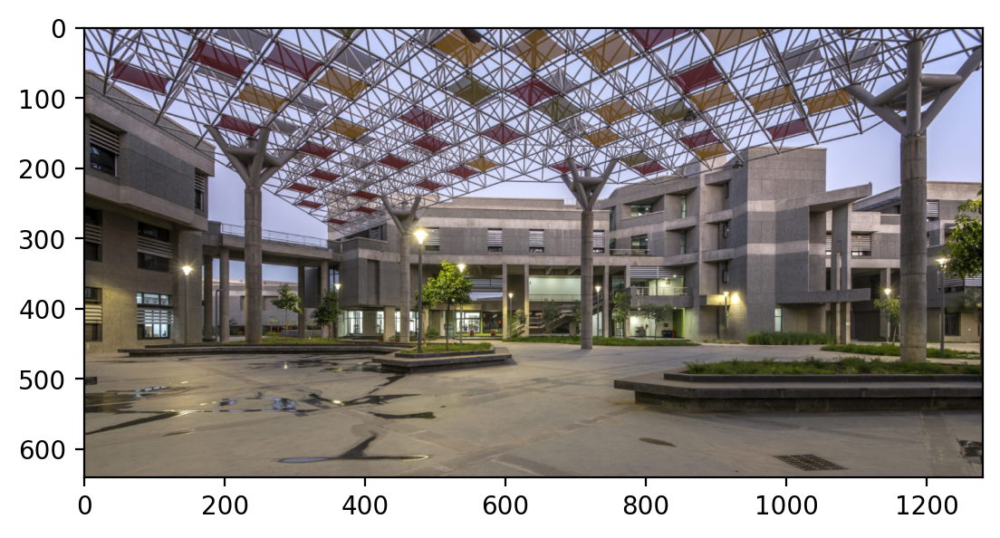

In [5]:
# Load and preprocess image
color_img = torchvision.io.read_image("./iitgn.jpg")
color_img = color_img.to(dtype=torch.float32)  # Ensure tensor is of type float

# Normalize the image
color_img = normalize_image(color_img)
# check min and max
print("Min pixel value:", color_img.min().item())
print("Max pixel value:", color_img.max().item())
plt.imshow(color_img.permute(1, 2, 0))

### Convert image to grayscale

torch.Size([640, 1280])


C:\Users\Shardul Junagade\AppData\Local\Temp\ipykernel_13984\2633341719.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  gray_img = torch.tensor(color_img, dtype=torch.float)


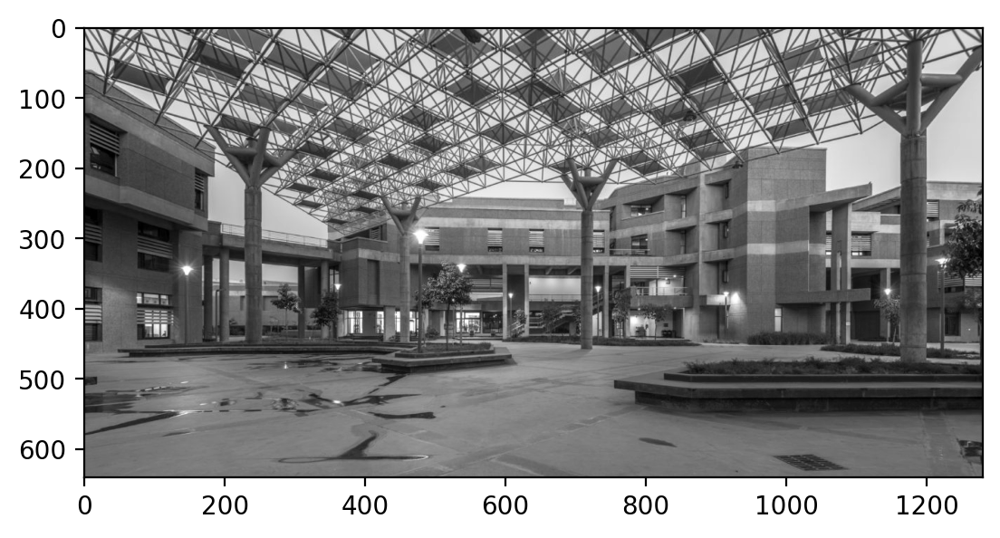

In [6]:
# Make grayscale
gray_img = torch.tensor(color_img, dtype=torch.float)
gray_img = gray_img.mean(dim=0, keepdim=False)
print(gray_img.shape)
plt.imshow(gray_img, cmap='gray')

### Crop the image

torch.Size([600, 600])


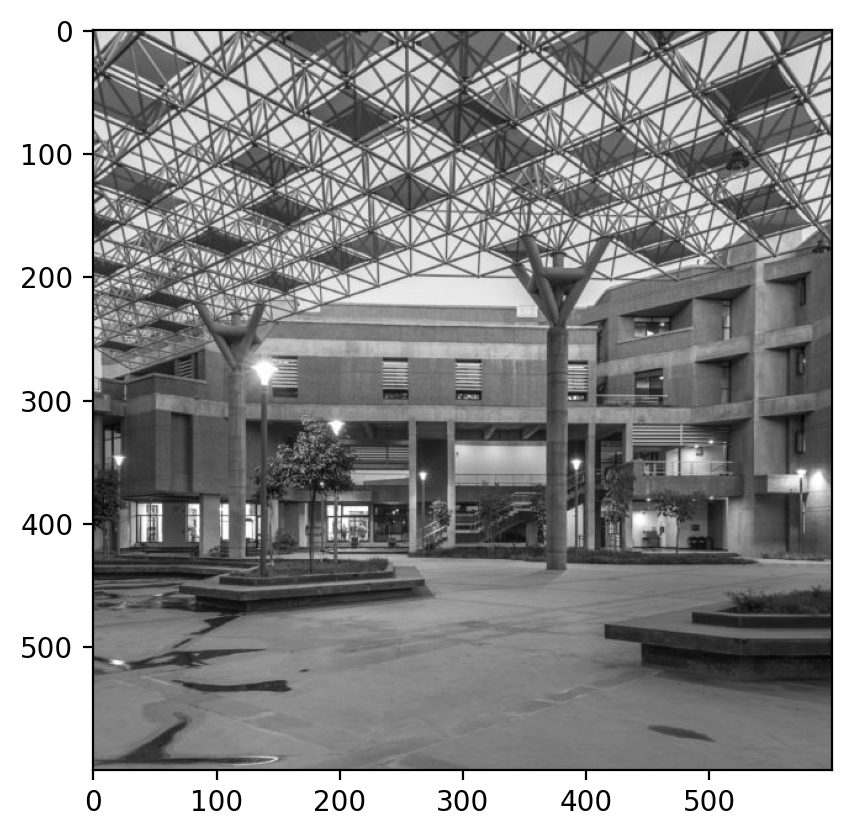

In [7]:
crop = torchvision.transforms.CenterCrop(600)
img_cropped = crop(gray_img)
print(img_cropped.shape)

plt.imshow(img_cropped, cmap='gray')

## Question 4.1

Q1. Pick an image of your liking and reconstruct it using matrix factorization. Choose a suitable value for the rank 
r
. Run Gradient Descent until it converges, plot the reconstructed image alongside the original image. Calculate and report the RMSE and PSNR metrics.

### Mask some random % of the image

In [8]:
def mask_image(image, mask_proportion=0.1, mask_value = float('nan')):
    if not isinstance(image, torch.Tensor):
        raise TypeError("Input 'image' must be a torch.Tensor.")
    
    if not (0 <= mask_proportion <= 1):
        raise ValueError("'mask_proportion' must be between 0 and 1.")
    
    img_copy = image.clone()
    mask = torch.rand(image.shape) < mask_proportion
    img_copy[mask] = mask_value

    return img_copy, mask

In [9]:
masked_img, mask = mask_image(img_cropped, mask_proportion=0.3)
mask.sum()

tensor(108480)

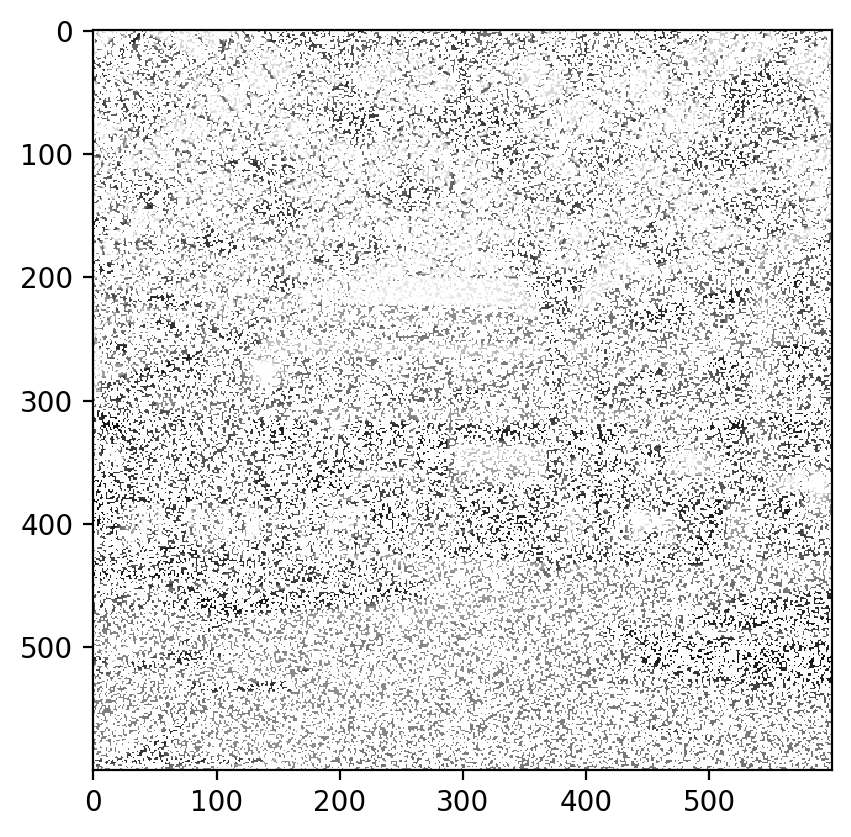

In [10]:
plt.imshow(masked_img, cmap='gray')

### Matrix Factorization

In [21]:
def load_image(image_path, crop_size=600):
    color_img = torchvision.io.read_image(image_path)
    color_img = color_img.to(dtype=torch.float32)
    # Normalize the image
    color_img = normalize_image(color_img)
    gray_img = torch.tensor(color_img, dtype=torch.float)
    gray_img = gray_img.mean(dim=0, keepdim=False)
    crop = torchvision.transforms.CenterCrop(crop_size)
    img_cropped = crop(gray_img)
    return img_cropped


def matrix_factorization(image_tensor, rank, learning_rate=0.01, num_epochs=5000, tol = 1e-6, device=torch.device("cpu")):
    """
    Perform matrix factorization using Alternating Least Squares (ALS) algorithm.
    
    Args:
        image_tensor (torch.Tensor): The image tensor to be factorized.
        rank (int): The rank of the factorization.
        learning_rate (float): The learning rate for optimization.
        num_epochs (int): The number of epochs to train the model.
        tol (float): The tolerance for convergence.
        device (torch.device): The device to run the optimization.
    
    Returns:
        W (torch.Tensor): The basis matrix.
        H (torch.Tensor): The coefficient matrix.
        loss (torch.Tensor): The final loss.
        losses (list): The list of losses at each epoch.
    """

    image_tensor = image_tensor.to(device)
    height, width = image_tensor.shape
    # Initialize the factors randomly
    W = torch.randn(height, rank, requires_grad=True, device=device)
    H = torch.randn(rank, width, requires_grad=True, device=device)
    # Optimizer
    optimizer = optim.Adam([W, H], lr=learning_rate)
    mask = ~torch.isnan(image_tensor)
    # Train the model
    losses = []
    prev_loss = float('inf')
    for i in range(1, num_epochs+1):
        # Compute the loss
        diff_matrix = torch.mm(W, H) - image_tensor
        diff_vector = diff_matrix[mask]
        loss = torch.norm(diff_vector)
        losses.append(loss.item())
        if i % 1000 == 0:
            print(f"Iteration {i}, loss: {loss.item()}")

        if abs(prev_loss - loss.item()) < tol:
            print(f"Converged at iteration {i}, loss: {loss.item()}")
            break
        prev_loss = loss.item()
        
        # Zero the gradients
        optimizer.zero_grad()

        # Backpropagate
        loss.backward()

        # Update the parameters
        optimizer.step()

    return W, H, loss, losses


def plot_images(original, masked, reconstructed,rank, mask_proportion):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    fig.suptitle(f"Image Reconstruction with Rank {rank} and Mask Proportion {mask_proportion}")
    # Original image
    axes[0].imshow(original.cpu().detach().numpy(), cmap='gray')
    axes[0].set_title("Original Image")
    axes[0].axis('off')
    # Masked image
    axes[1].imshow(masked.cpu().detach().numpy(), cmap='gray')
    axes[1].set_title("Masked Image")
    axes[1].axis('off')
    # Reconstructed image
    axes[2].imshow(reconstructed.cpu().detach().numpy(), cmap='gray')
    axes[2].set_title("Reconstructed Image")
    axes[2].axis('off')
    plt.show()


def calculate_rmse_psnr(original, reconstructed):
    # Ensure both tensors are on the same device
    if original.device != reconstructed.device:
        original = original.to(reconstructed.device)   
    mse = F.mse_loss(reconstructed, original)
    rmse = torch.sqrt(mse)
    print(f"RMSE: {rmse.item()}")
    
    # PSNR: Peak Signal to Noise Ratio
    max_pixel_value = 1.0  # Since image is normalized to [0,1]
    psnr = 20 * torch.log10(max_pixel_value / torch.sqrt(mse))
    print(f"PSNR: {psnr.item()}")

    return rmse.item(), psnr.item()


def image_reconstruction(image_tensor, rank, mask_proportion=0.1, learning_rate=0.01, num_epochs=5000, tol=1e-6, device=torch.device("cpu")):
    image_tensor = image_tensor.to(device)
    # Mask the image
    masked_img, mask = mask_image(image_tensor, mask_proportion)
    # Factorize the masked_img image
    W, H, loss, losses = matrix_factorization(masked_img, rank, learning_rate, num_epochs, tol, device)
    # Reconstruct the image
    reconstructed = torch.mm(W, H)
    # Clamp the images to [0, 1]
    reconstructed = torch.clamp(reconstructed, 0, 1)
    # Calculate RMSE and PSNR
    rmse, psnr = calculate_rmse_psnr(image_tensor, reconstructed)
    # Plot the original and reconstructed
    plot_images(image_tensor, masked_img, reconstructed, rank, mask_proportion)
    
    return reconstructed, masked_img, loss, losses,  rmse, psnr

### Image Reconstruction

Iteration 1000, loss: 49.02236557006836
Iteration 2000, loss: 41.508087158203125
Converged at iteration 2425, loss: 39.60524368286133
RMSE: 0.08949604630470276
PSNR: 20.963924407958984


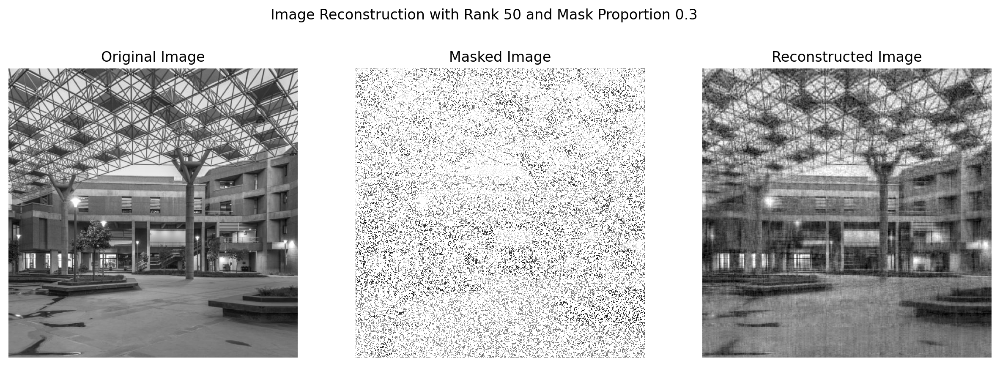

In [22]:
reconstructed_img, masked_img, loss, losses, rmse, psnr = image_reconstruction(img_cropped, 50, mask_proportion=0.3, learning_rate=0.01, num_epochs=10000, device=device)

Text(0.5, 1.0, 'Loss vs. Epoch')

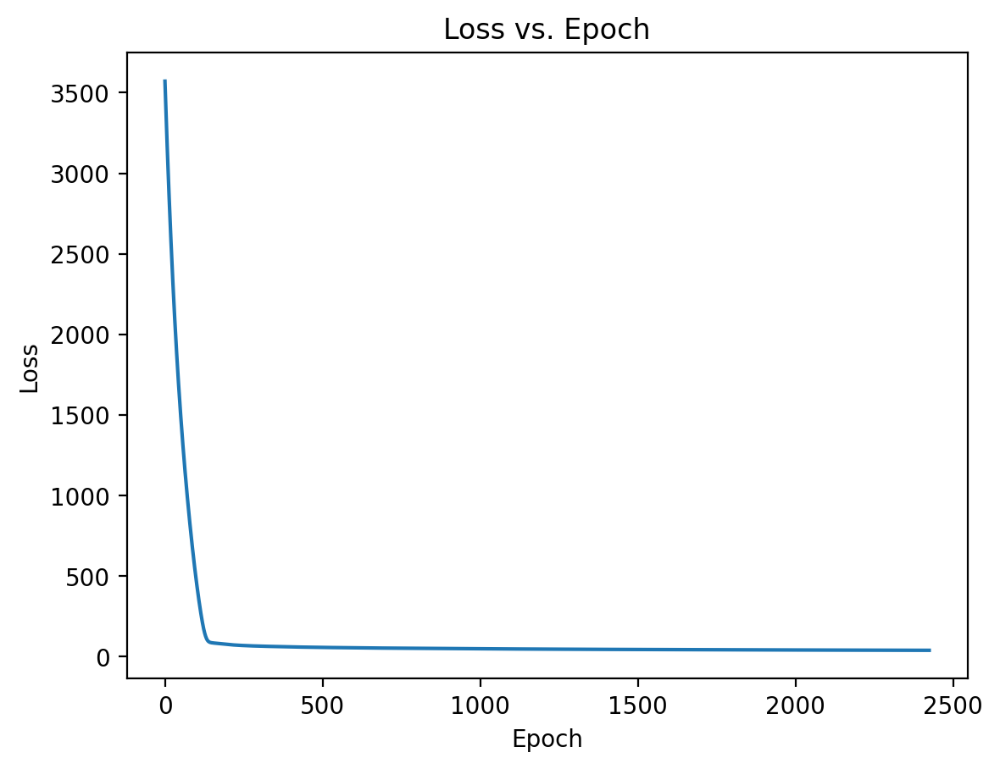

In [23]:
plt.figure()
plt.plot(losses)
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Loss vs. Epoch")

### Evaluating Matrix Factorization Performance Across Different Ranks

--------------------------------------------------
Evaluating rank: 5
--------------------------------------------------
Iteration 1000, loss: 78.42890930175781
Iteration 2000, loss: 74.78265380859375
Iteration 3000, loss: 73.71866607666016
Converged at iteration 3384, loss: 73.55327606201172
RMSE: 0.14752346277236938
PSNR: 16.622777938842773


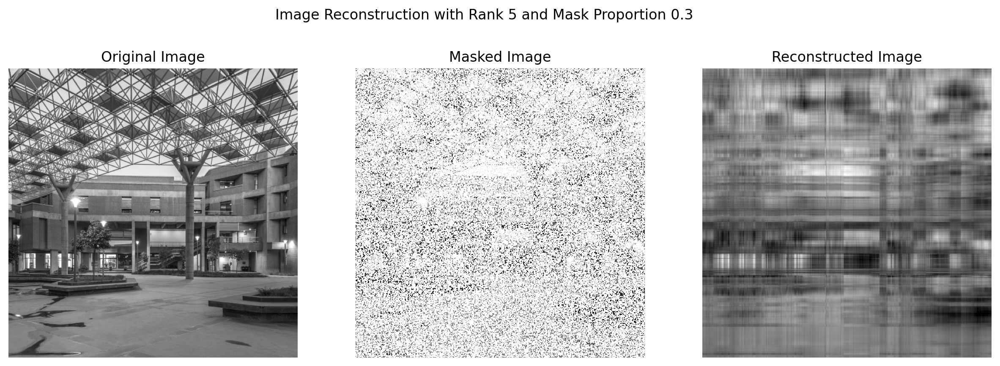




--------------------------------------------------
Evaluating rank: 10
--------------------------------------------------
Iteration 1000, loss: 71.30886840820312
Iteration 2000, loss: 63.48197555541992
Iteration 3000, loss: 61.97865676879883
Converged at iteration 3514, loss: 61.88930130004883
RMSE: 0.12546494603157043
PSNR: 18.029552459716797


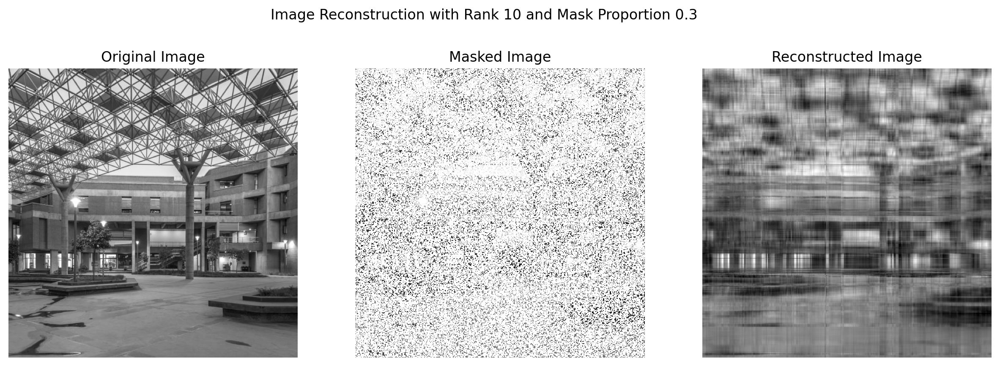




--------------------------------------------------
Evaluating rank: 20
--------------------------------------------------
Iteration 1000, loss: 62.194007873535156
Iteration 2000, loss: 54.882755279541016
Iteration 3000, loss: 52.228145599365234
Iteration 4000, loss: 51.18766784667969
Converged at iteration 4255, loss: 51.081085205078125
RMSE: 0.1061006411910057
PSNR: 19.485641479492188


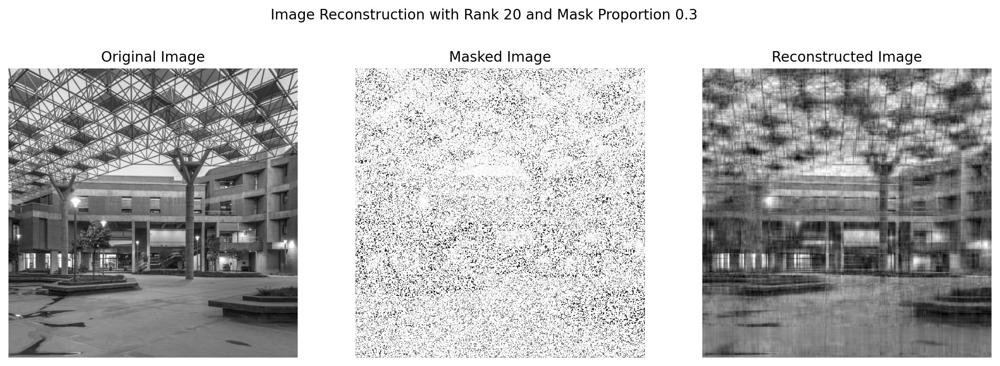




--------------------------------------------------
Evaluating rank: 30
--------------------------------------------------
Iteration 1000, loss: 57.19871139526367
Iteration 2000, loss: 49.454341888427734
Iteration 3000, loss: 46.10273361206055
Iteration 4000, loss: 44.75287628173828
Converged at iteration 4200, loss: 44.620269775390625
RMSE: 0.09586567431688309
PSNR: 20.366735458374023


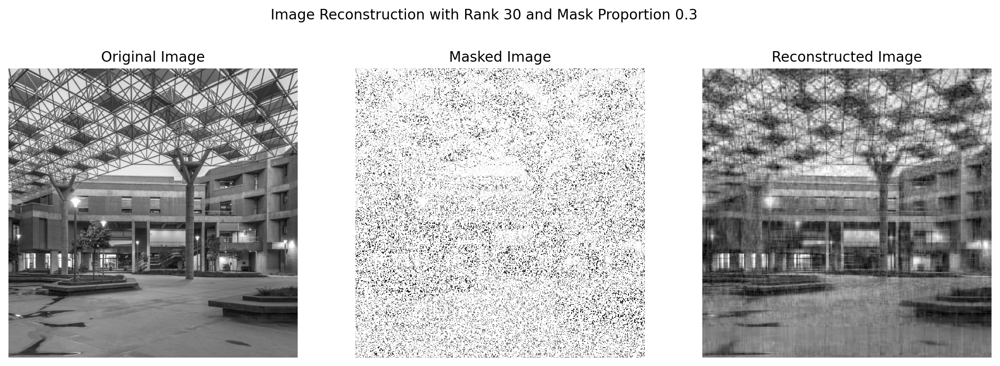




--------------------------------------------------
Evaluating rank: 50
--------------------------------------------------
Iteration 1000, loss: 49.042144775390625
Iteration 2000, loss: 41.41209030151367
Iteration 3000, loss: 37.71476745605469
Iteration 4000, loss: 35.755706787109375
Iteration 5000, loss: 34.74480438232422
Converged at iteration 5391, loss: 34.57971954345703
RMSE: 0.08096364885568619
PSNR: 21.834199905395508


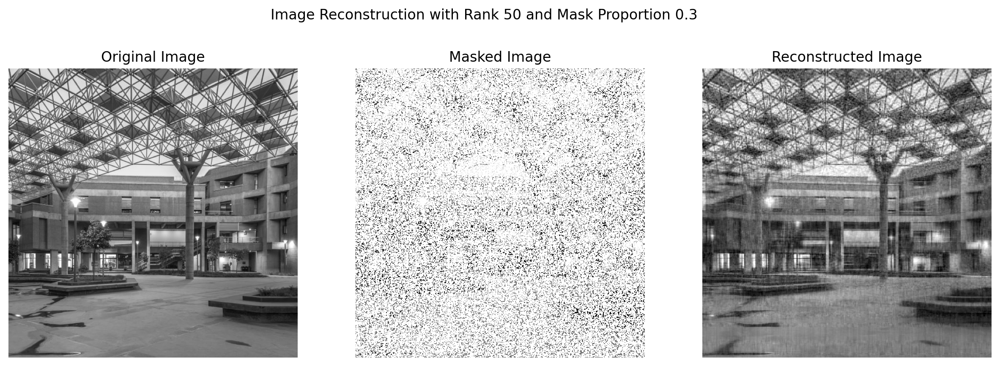




--------------------------------------------------
Evaluating rank: 100
--------------------------------------------------
Iteration 1000, loss: 37.50946807861328
Iteration 2000, loss: 29.545310974121094
Iteration 3000, loss: 25.778602600097656
Iteration 4000, loss: 23.410076141357422
Iteration 5000, loss: 21.775386810302734
Iteration 6000, loss: 20.715429306030273
Iteration 7000, loss: 19.888870239257812
Iteration 8000, loss: 19.300323486328125
Iteration 9000, loss: 18.83821678161621
Iteration 10000, loss: 18.53740882873535
RMSE: 0.06234115734696388
PSNR: 24.104501724243164


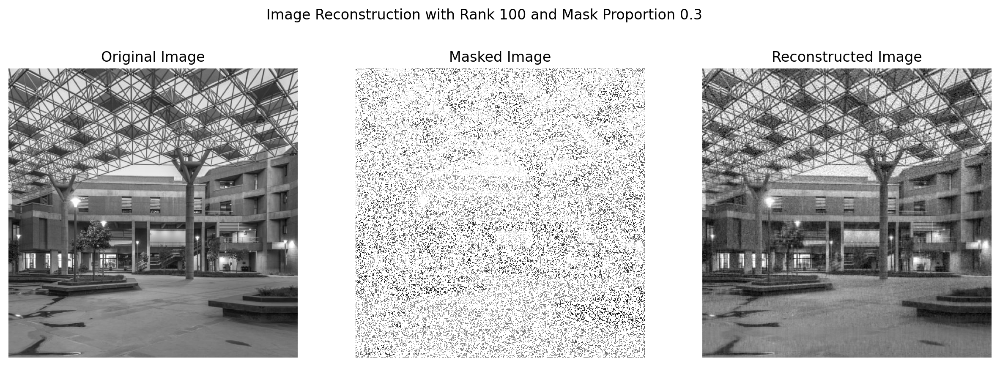

In [24]:
ranks = [5, 10, 20, 30, 50, 100]
results = {}

for rank in ranks:
    print("-"*50)
    print(f"Evaluating rank: {rank}")
    print("-"*50)
    reconstructed_img, masked_img, loss, losses, rmse, psnr = image_reconstruction(
        img_cropped, rank, mask_proportion=0.3, learning_rate=0.01, num_epochs=10000, device=device
    )
    results[rank] = {'Loss': loss, 'RMSE': rmse, 'PSNR': psnr}
    print("\n\n")


Rank: 5, Loss: 73.55327606201172, RMSE: 0.14752346277236938, PSNR: 16.622777938842773
Rank: 10, Loss: 61.88930130004883, RMSE: 0.12546494603157043, PSNR: 18.029552459716797
Rank: 20, Loss: 51.081085205078125, RMSE: 0.1061006411910057, PSNR: 19.485641479492188
Rank: 30, Loss: 44.620269775390625, RMSE: 0.09586567431688309, PSNR: 20.366735458374023
Rank: 50, Loss: 34.57971954345703, RMSE: 0.08096364885568619, PSNR: 21.834199905395508
Rank: 100, Loss: 18.53740882873535, RMSE: 0.06234115734696388, PSNR: 24.104501724243164


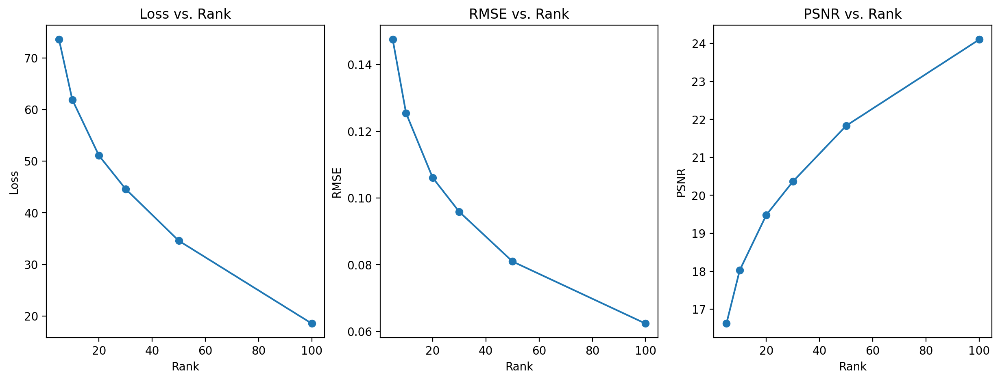

In [25]:
# Print the results for each rank
for rank, metrics in results.items():
    print(f"Rank: {rank}, Loss: {metrics['Loss']}, RMSE: {metrics['RMSE']}, PSNR: {metrics['PSNR']}")
    
# Optional: Plot the RMSE and PSNR for different ranks
ranks_list = list(results.keys())
loss_list = [metrics['Loss'].cpu().detach().numpy() for metrics in results.values()]
rmse_list = [metrics['RMSE'] for metrics in results.values()]
psnr_list = [metrics['PSNR'] for metrics in results.values()]

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.plot(ranks_list, loss_list, marker='o')
plt.xlabel('Rank')
plt.ylabel('Loss')
plt.title('Loss vs. Rank')

plt.subplot(1, 3, 2)
plt.plot(ranks_list, rmse_list, marker='o')
plt.xlabel('Rank')
plt.ylabel('RMSE')
plt.title('RMSE vs. Rank')

plt.subplot(1, 3, 3)
plt.plot(ranks_list, psnr_list, marker='o')
plt.xlabel('Rank')
plt.ylabel('PSNR')
plt.title('PSNR vs. Rank')

plt.show()


### Experimenting with different Mask Proportions

--------------------------------------------------
Testing with mask proportion: 0.1
--------------------------------------------------
Iteration 1000, loss: 57.14606475830078
Iteration 2000, loss: 48.78229522705078
Converged at iteration 2133, loss: 48.084102630615234
RMSE: 0.08706387877464294
PSNR: 21.2032413482666


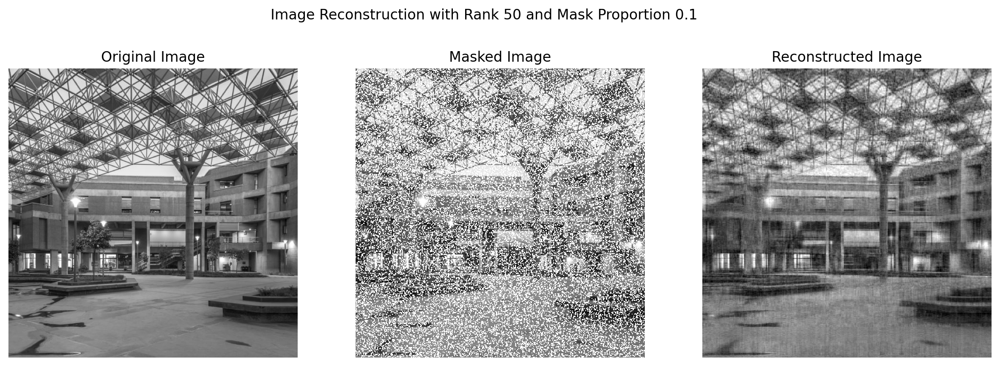




--------------------------------------------------
Testing with mask proportion: 0.3
--------------------------------------------------
Iteration 1000, loss: 49.11054992675781
Iteration 2000, loss: 41.50035095214844
Converged at iteration 2914, loss: 37.82011795043945
RMSE: 0.08598233759403229
PSNR: 21.31181526184082


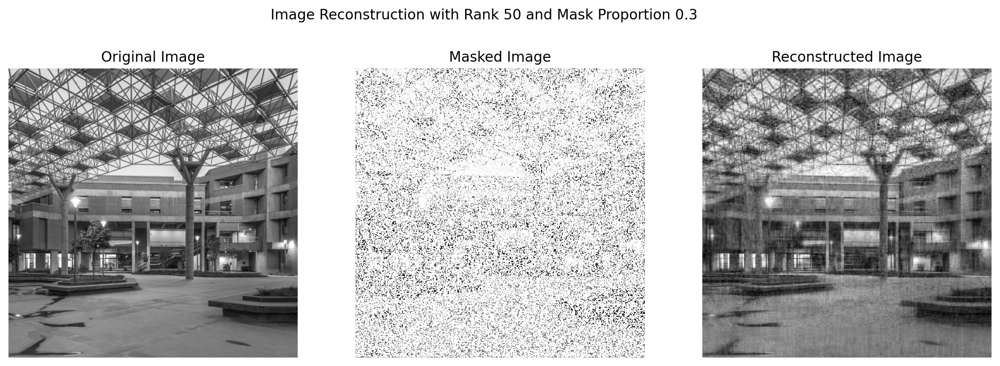




--------------------------------------------------
Testing with mask proportion: 0.5
--------------------------------------------------
Iteration 1000, loss: 38.79701232910156
Iteration 2000, loss: 32.0305290222168
Iteration 3000, loss: 28.71734046936035
Iteration 4000, loss: 27.12981414794922
Iteration 5000, loss: 26.41508674621582
Iteration 6000, loss: 26.062952041625977
Converged at iteration 6141, loss: 26.022357940673828
RMSE: 0.09624196588993073
PSNR: 20.332714080810547


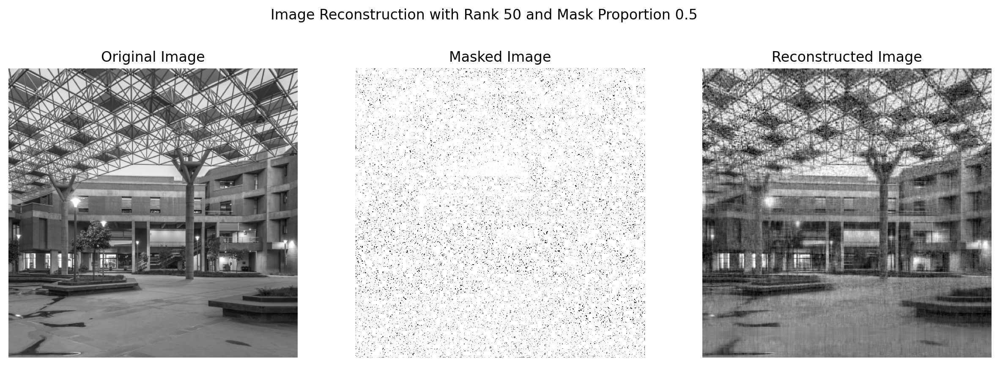




--------------------------------------------------
Testing with mask proportion: 0.7
--------------------------------------------------
Iteration 1000, loss: 24.273136138916016
Iteration 2000, loss: 17.992441177368164
Iteration 3000, loss: 15.62304973602295
Converged at iteration 3075, loss: 15.51546573638916
RMSE: 0.15284201502799988
PSNR: 16.31514549255371


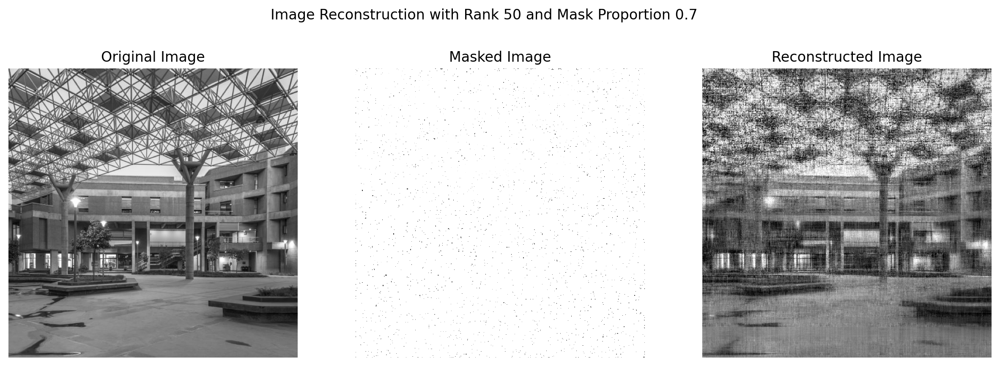




--------------------------------------------------
Testing with mask proportion: 0.9
--------------------------------------------------
Iteration 1000, loss: 1.3461041450500488
Iteration 2000, loss: 1.4069749116897583
Iteration 3000, loss: 1.6371954679489136
Iteration 4000, loss: 1.3072099685668945
Iteration 5000, loss: 1.2213400602340698
Iteration 6000, loss: 1.1848245859146118
Iteration 7000, loss: 1.3819173574447632
Iteration 8000, loss: 1.3171700239181519
Iteration 9000, loss: 1.1335268020629883
Iteration 10000, loss: 1.0505914688110352
RMSE: 0.48452839255332947
PSNR: 6.293615818023682


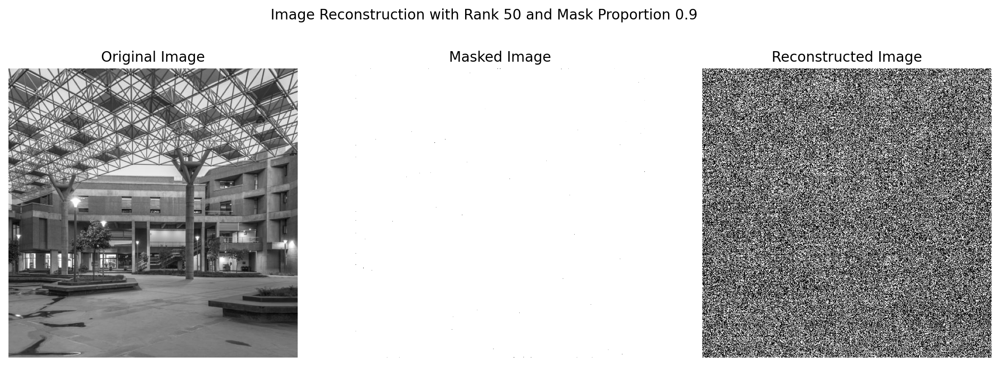

In [26]:
mask_proportions = [0.1, 0.3, 0.5, 0.7, 0.9]

results = {}

for proportion in mask_proportions:
    print("-"*50)
    print(f"Testing with mask proportion: {proportion}")
    print("-"*50)

    # Perform image reconstruction
    reconstructed_img, masked_img, loss, losses, rmse, psnr = image_reconstruction(
        img_cropped,
        rank=50,
        mask_proportion=proportion,
        learning_rate=0.01,
        num_epochs=10000,
        device=device
    )

    # Store results
    results[proportion] = {
        'Loss': loss,
        'RMSE': rmse,
        'PSNR': psnr
    }
    print("\n\n")

Mask Proportion: 0.1, Loss: 48.084102630615234, RMSE: 0.08706387877464294, PSNR: 21.2032413482666
Mask Proportion: 0.3, Loss: 37.82011795043945, RMSE: 0.08598233759403229, PSNR: 21.31181526184082
Mask Proportion: 0.5, Loss: 26.022357940673828, RMSE: 0.09624196588993073, PSNR: 20.332714080810547
Mask Proportion: 0.7, Loss: 15.51546573638916, RMSE: 0.15284201502799988, PSNR: 16.31514549255371
Mask Proportion: 0.9, Loss: 1.0505914688110352, RMSE: 0.48452839255332947, PSNR: 6.293615818023682


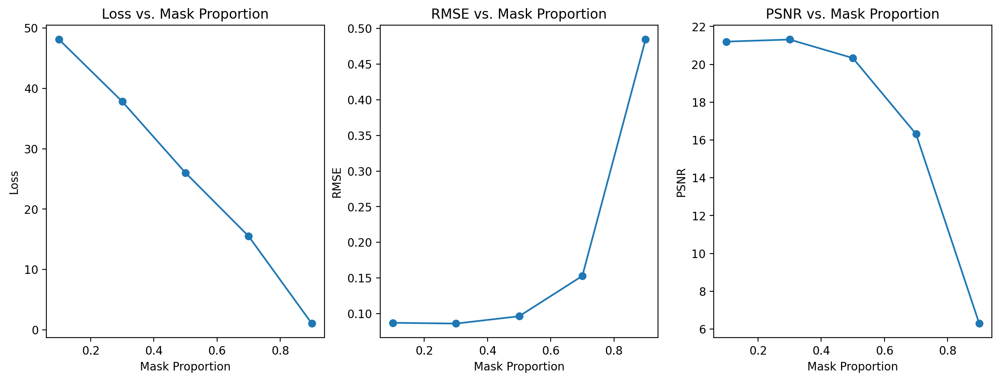

In [27]:
for proportion, metrics in results.items():
    print(f"Mask Proportion: {proportion}, Loss: {metrics['Loss']}, RMSE: {metrics['RMSE']}, PSNR: {metrics['PSNR']}")

# Optional: Plot the Loss, RMSE, and PSNR for different mask proportions
proportions_list = list(results.keys())
loss_list = [metrics['Loss'].cpu().detach().numpy() for metrics in results.values()]
rmse_list = [metrics['RMSE'] for metrics in results.values()]
psnr_list = [metrics['PSNR'] for metrics in results.values()]

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.plot(proportions_list, loss_list, marker='o')
plt.xlabel('Mask Proportion')
plt.ylabel('Loss')
plt.title('Loss vs. Mask Proportion')

plt.subplot(1, 3, 2)
plt.plot(proportions_list, rmse_list, marker='o')
plt.xlabel('Mask Proportion')
plt.ylabel('RMSE')
plt.title('RMSE vs. Mask Proportion')

plt.subplot(1, 3, 3)
plt.plot(proportions_list, psnr_list, marker='o')
plt.xlabel('Mask Proportion')
plt.ylabel('PSNR')
plt.title('PSNR vs. Mask Proportion')

plt.show()